In [2]:
!git clone https://github.com/JunkyByte/easy_ViTPose.git
!cd easy_ViTPose/ && pip install -r requirements.txt && pip install -e .
%pip install huggingface_hub

Cloning into 'easy_ViTPose'...


remote: Enumerating objects: 889, done.
remote: Counting objects: 100% (305/305), done.
remote: Compressing objects: 100% (115/115), done.
remote: Total 889 (delta 221), reused 266 (delta 189), pack-reused 584
Receiving objects: 100% (889/889), 9.83 MiB | 6.71 MiB/s, done.
Resolving deltas: 100% (528/528), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.4/126.4 kB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.2/247.2 kB 5.8 MB/s eta 0:00:0000:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 19.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 21.9 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.0/313.0 kB 27.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.1/68.1 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━

In [3]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import os
from huggingface_hub import hf_hub_download

AttributeError: module 'cv2.dnn' has no attribute 'DictValue'

In [ ]:
#@title Choose model and run this cell

MODEL_SIZE = 'b'  #@param ['s', 'b', 'l', 'h']
YOLO_SIZE = 'n'  #@param ['s', 'n']
DATASET = 'apt36k'  #@param ['coco_25', 'coco', 'wholebody', 'mpii', 'aic', 'ap10k', 'apt36k']
ext = '.pth'
ext_yolo = '.pt'

In [ ]:
MODEL_TYPE = "torch"
YOLO_TYPE = "torch"
REPO_ID = 'JunkyByte/easy_ViTPose'
FILENAME = os.path.join(MODEL_TYPE, f'{DATASET}/vitpose-' + MODEL_SIZE + f'-{DATASET}') + ext
FILENAME_YOLO = 'yolov8/yolov8' + YOLO_SIZE + ext_yolo

print(f'Downloading model {REPO_ID}/{FILENAME}')
model_path = hf_hub_download(repo_id=REPO_ID, filename=FILENAME)
yolo_path = hf_hub_download(repo_id=REPO_ID, filename=FILENAME_YOLO)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


vitpose-b-apt36k.pth:   0%|          | 0.00/360M [00:00<?, ?B/s]

yolov8n.pt:   0%|          | 0.00/6.53M [00:00<?, ?B/s]

In [ ]:
# If you get an error from PIL restart environment and rerun this cell to update packages version
from easy_ViTPose import VitInference
model = VitInference(model_path, yolo_path, MODEL_SIZE,
                     dataset=DATASET, yolo_size=320, is_video=False)

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
im = cv2.imread('177.JPG')
im_rgb = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
im_array = np.array(im_rgb, dtype=np.uint8)
im_array

array([[[ 77,  90,  70],
        [ 75,  88,  68],
        [ 84,  97,  77],
        ...,
        [ 65,  82,  64],
        [ 65,  82,  64],
        [ 57,  74,  56]],

       [[ 72,  85,  65],
        [ 65,  78,  58],
        [ 73,  88,  67],
        ...,
        [ 64,  81,  65],
        [ 56,  70,  55],
        [ 55,  69,  54]],

       [[ 84,  99,  78],
        [ 85, 100,  79],
        [ 81,  96,  75],
        ...,
        [ 68,  82,  69],
        [ 61,  75,  60],
        [ 59,  73,  58]],

       ...,

       [[165, 179, 156],
        [161, 175, 152],
        [161, 173, 151],
        ...,
        [107, 134,   5],
        [111, 140,  12],
        [116, 145,  17]],

       [[159, 171, 149],
        [157, 169, 147],
        [160, 172, 150],
        ...,
        [117, 147,  17],
        [114, 145,  16],
        [116, 147,  18]],

       [[159, 171, 149],
        [156, 168, 146],
        [156, 168, 146],
        ...,
        [110, 141,  11],
        [111, 142,  13],
        [ 96, 127,   0]]

In [ ]:
frame_keypoints = model.inference(im_array)

WARNING ⚠️ NMS time limit 0.550s exceeded


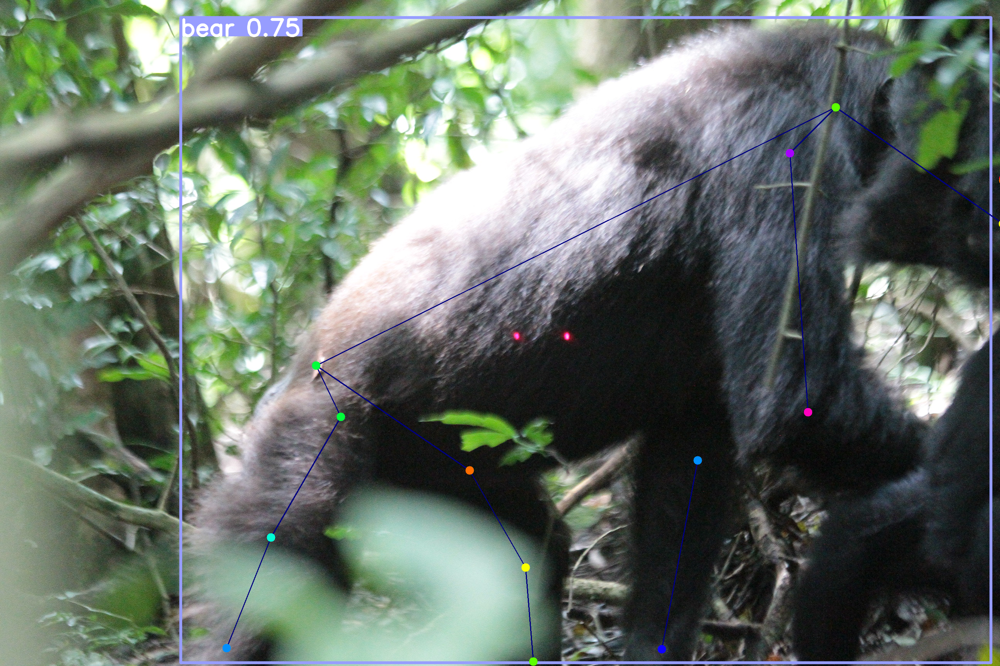

In [ ]:
img = model.draw(show_yolo=True)
cv2_imshow(img[..., ::-1])

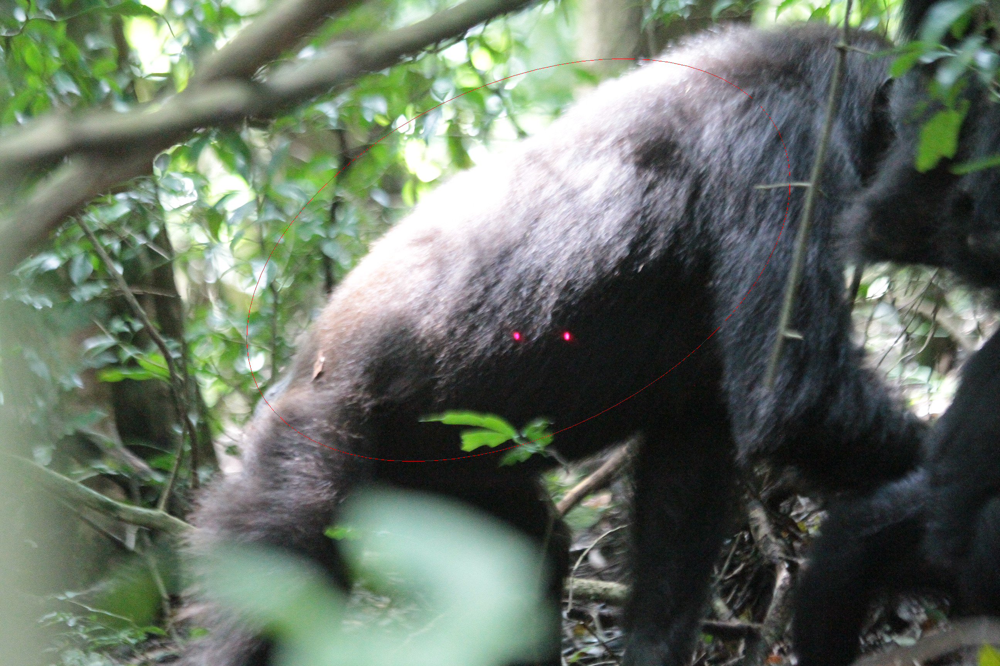

In [ ]:
shoulder = frame_keypoints[0][3]
shoulder = [shoulder[1], shoulder[0]]

rump = frame_keypoints[0][4]
rump = [rump[1], rump[0]]

center = ((shoulder[0] + rump[0]) / 2, (shoulder[1] + rump[1]) / 2)
center = (int(center[0] - (center[0] / 10)), int(center[1] + (center[1] / 10))) # Slightly adjust center

major_axis_length = np.sqrt(((shoulder[0] - rump[0])**2) + ((shoulder[1] - rump[1])**2))
half_major_axis = int(major_axis_length / 2)

minor_axis_length = int(0.6 * major_axis_length)  # Assume a minor axis 3/5 the length of the major axis (adjust as needed)
half_minor_axis = int(minor_axis_length / 2)

angle = np.rad2deg(np.arctan2(rump[1] - shoulder[1], rump[0] - shoulder[0]))  # Calculate angle in degrees
image = cv2.ellipse(im, center, (half_major_axis, half_minor_axis), angle, 0, 360, (0,0,255))


# Displaying the image
cv2_imshow(image)

In [ ]:
image = cv2.ellipse(im, center, (half_major_axis, half_minor_axis), angle, 0, 360, (0,0,255))

[[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


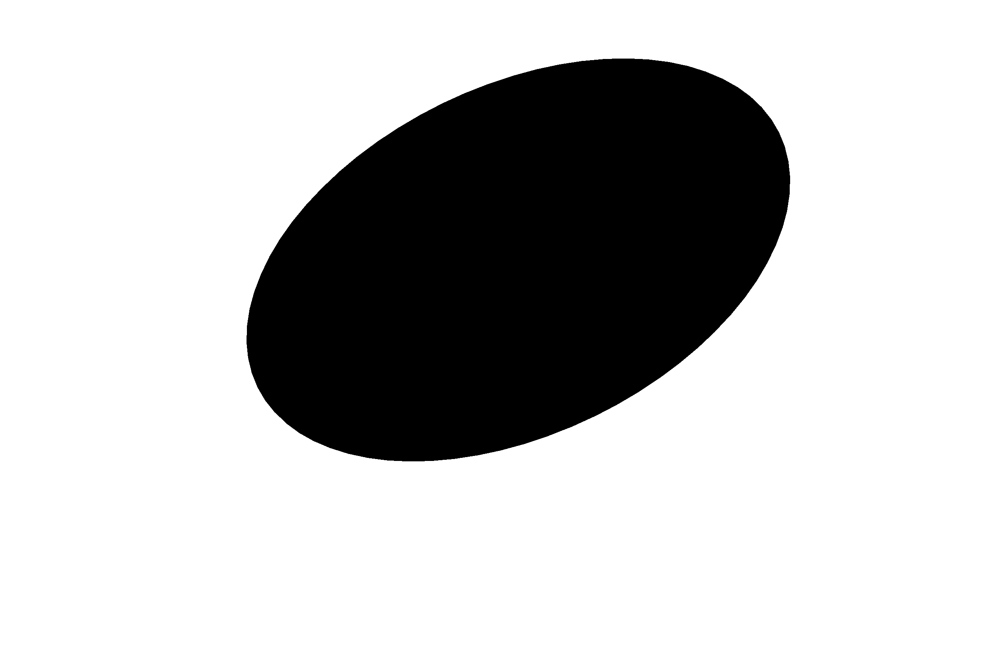

In [ ]:
width, height = im.shape[1], im.shape[0]
blank_image = np.ones((height, width, 3), np.uint8) * 255

# COPIED FROM EARLIER CELL
# ------------------------------------------------------------------------------------------------------------------------
shoulder = frame_keypoints[0][3]
shoulder = [shoulder[1], shoulder[0]]

rump = frame_keypoints[0][4]
rump = [rump[1], rump[0]]

center = ((shoulder[0] + rump[0]) / 2, (shoulder[1] + rump[1]) / 2)
center = (int(center[0] - (center[0] / 10)), int(center[1] + (center[1] / 10))) # Slightly adjust center

major_axis_length = np.sqrt(((shoulder[0] - rump[0])**2) + ((shoulder[1] - rump[1])**2))
half_major_axis = int(major_axis_length / 2)

minor_axis_length = int(0.6 * major_axis_length)  # Assume a minor axis 3/5 the length of the major axis (adjust as needed)
half_minor_axis = int(minor_axis_length / 2)

angle = np.rad2deg(np.arctan2(rump[1] - shoulder[1], rump[0] - shoulder[0]))  # Calculate angle in degrees
# ------------------------------------------------------------------------------------------------------------------------

color = (0,0,0)
thickness = -1

grey_ellipse = cv2.ellipse(blank_image, center, (half_major_axis, half_minor_axis), angle, 0, 360, color, thickness)
grey_ellipse = cv2.cvtColor(grey_ellipse, cv2.COLOR_BGR2GRAY)
print(grey_ellipse)

# Display the original and greyscale images
cv2_imshow(grey_ellipse)

In [ ]:
import torch
import torchvision
print("PyTorch version:", torch.__version__)
print("Torchvision version:", torchvision.__version__)
print("CUDA is available:", torch.cuda.is_available())
import sys
!{sys.executable} -m pip install opencv-python matplotlib
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

!mkdir images
!wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/truck.jpg
!wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/groceries.jpg

!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

PyTorch version: 2.1.0+cu121
Torchvision version: 0.16.0+cu121
CUDA is available: True
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-u2oqxli4
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-u2oqxli4
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36587 sha256=222633259cda0b276205ada98020f8692dbefb1889073e6441df8b746bc733b6
  Stored in directory: /tmp/pip-ephem-wheel-cache-qtpza7k3/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
--2024-02-20 20:33:18--  https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/truck.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.c

In [ ]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

In [ ]:
segment_im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

In [ ]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

In [ ]:
predictor.set_image(segment_im)
input_point = np.array([[1450, 1000]]) #cambiaste esto
input_label = np.array([1])

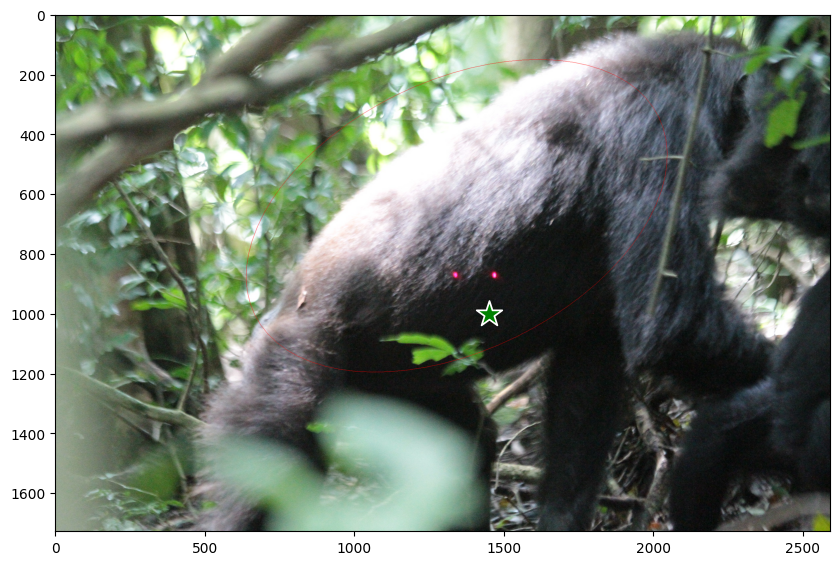

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(segment_im)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()

In [ ]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

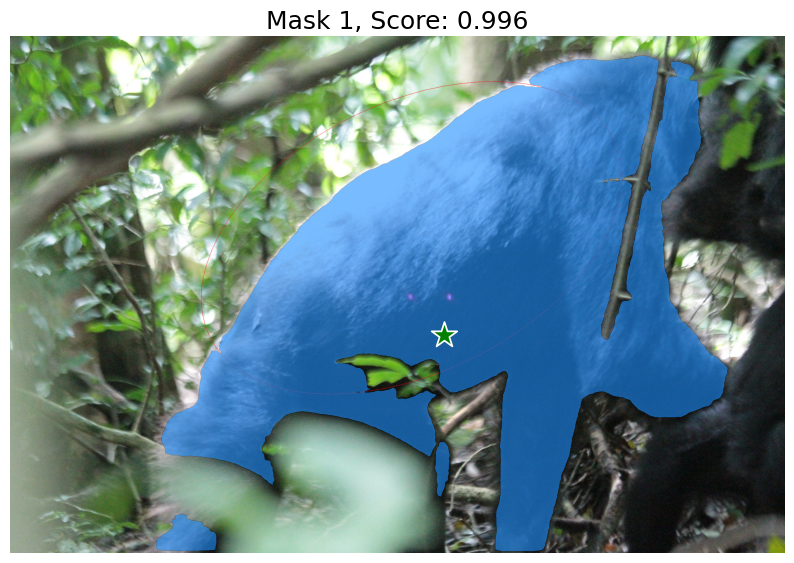

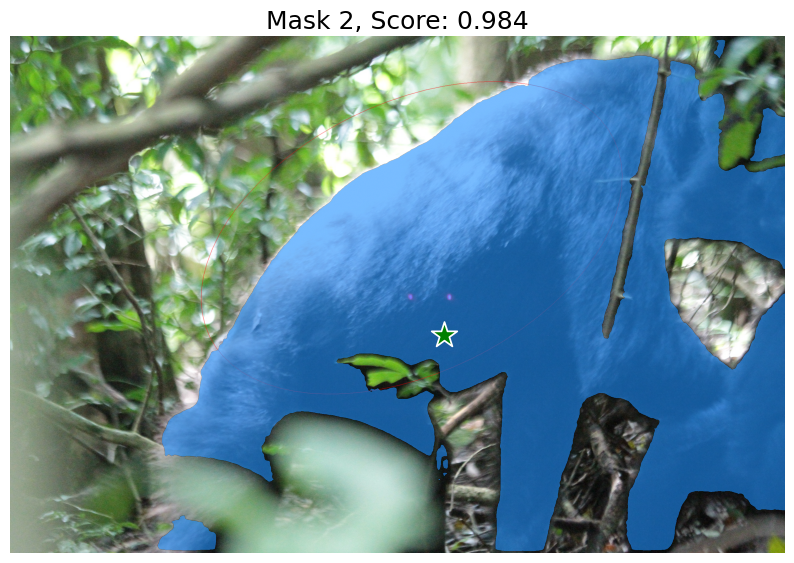

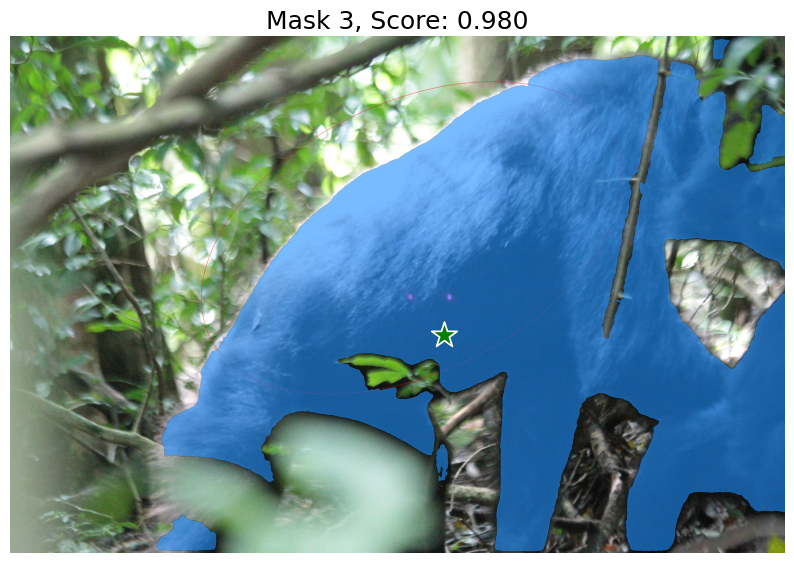

In [ ]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(segment_im)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()

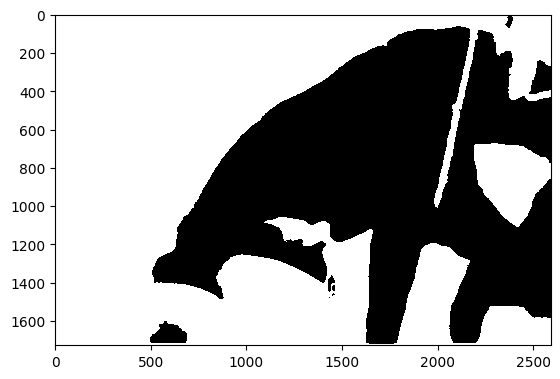

In [ ]:
segmentation_mask = masks[1]
segmentation_mask_reformatted = [[255 if not value else 0 for value in row] for row in segmentation_mask]

plt.imshow(segmentation_mask_reformatted, cmap='gray', interpolation='nearest')
plt.show()

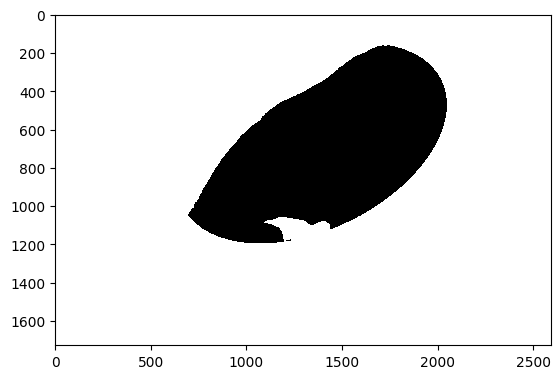

In [ ]:
ROWS, COLS = len(grey_ellipse), len(grey_ellipse[0])
cropped_torso = [['unprocessed' for c in range(COLS)] for r in range(ROWS)]
for r in range(ROWS):
    for c in range(COLS):
        if grey_ellipse[r][c] == 0 and segmentation_mask_reformatted[r][c] == 0:
            cropped_torso[r][c] = 0
        else:
            cropped_torso[r][c] = 255

plt.imshow(cropped_torso, cmap='gray', interpolation='nearest')
plt.show()

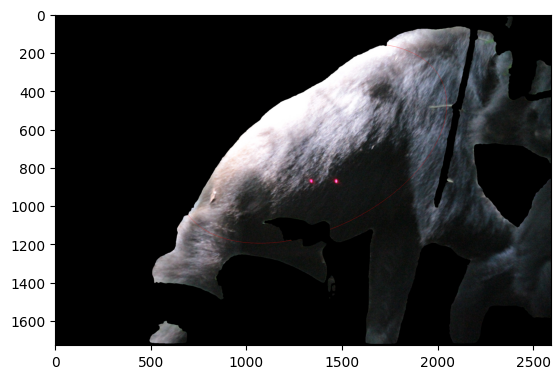

In [ ]:
best_mask = segmentation_mask
output = np.zeros_like(segment_im)
output[best_mask] = segment_im[best_mask]
plt.imshow(output)
plt.show()

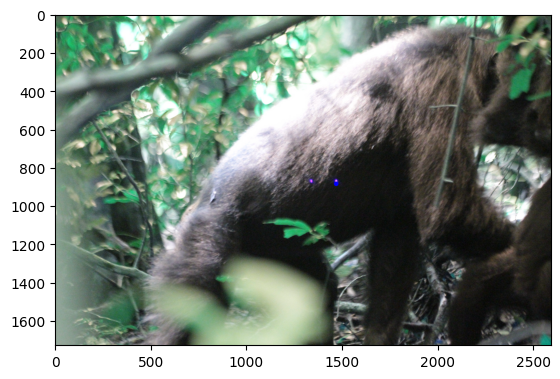

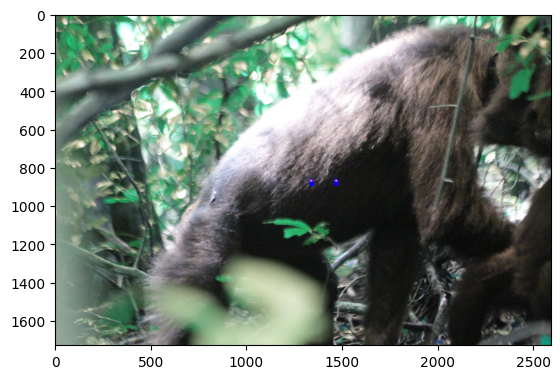

In [ ]:

from skimage.feature import blob_log

img = cv2.imread('177.JPG')
#img2 = output

# Assuming 'img' is your input image
hsv_frame = cv2.cvtColor(img, cv2.COLOR_BGR2HSV) #convert from BGR to HSV

# Define two ranges for red (due to the circular nature of the hue scale in HSV)
low_red1 = np.array([0, 120, 70])
high_red1 = np.array([10, 255, 255])
low_red2 = np.array([170, 120, 70])
high_red2 = np.array([180, 255, 255])

# Create masks for the red ranges
red_mask1 = cv2.inRange(hsv_frame, low_red1, high_red1)
red_mask2 = cv2.inRange(hsv_frame, low_red2, high_red2)
red_mask = cv2.bitwise_or(red_mask1, red_mask2)

# Apply mask to the image
red = cv2.bitwise_and(img, img, mask=red_mask)

# Extract red channel for processing (assuming red dots are the brightest in the red channel)
r = red[:,:,2]

# Apply Gaussian blur for smoothing
blur = cv2.GaussianBlur(r, (25, 25), 0)

# Apply thresholding
ret3, thresh = cv2.threshold(blur, 210, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Dilation to enlarge dots (tune parameters as needed)
thresh = cv2.dilate(thresh, (5, 5), iterations=28)

# Blob detection
blobs = blob_log(thresh, max_sigma=50, threshold=0.15)
count =0
if blobs.size != 0:  #checks if a blob was found
# ax[1].imshow(thresh, cmap='gray')
    for blob in blobs[:2,:]:
        y, x, area = blob
        if area>1:   #checks for area of blob
            count +=1

            result1 = cv2.circle(img, (int(x),int(y)),12,(0,0,255),-1) # draws circles on detected blob
            plt.imshow(result1)
            plt.show()

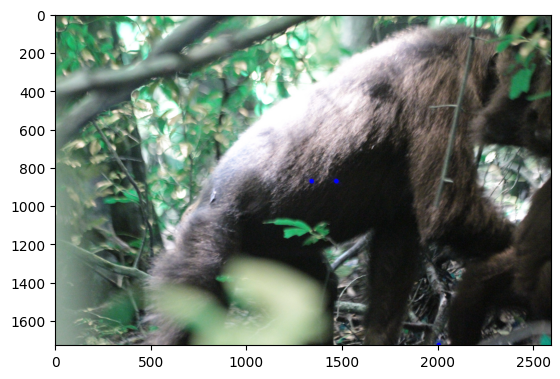

In [ ]:
import cv2
import numpy as np
from skimage.feature import blob_log
import matplotlib.pyplot as plt

# Load the image
img = cv2.imread('177.JPG')  # Update with the path to your image

# Convert from BGR to HSV
hsv_frame = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Define two ranges for red
low_red1 = np.array([0, 120, 70])
high_red1 = np.array([10, 255, 255])
low_red2 = np.array([170, 120, 70])
high_red2 = np.array([180, 255, 255])

# Create masks for red ranges
red_mask1 = cv2.inRange(hsv_frame, low_red1, high_red1)
red_mask2 = cv2.inRange(hsv_frame, low_red2, high_red2)
red_mask = cv2.bitwise_or(red_mask1, red_mask2)

# Apply mask to the image
red = cv2.bitwise_and(img, img, mask=red_mask)

# Extract red channel for processing
r = red[:,:,2]

# Apply Gaussian blur for smoothing
blur = cv2.GaussianBlur(r, (25, 25), 0)

# Apply thresholding
ret3, thresh = cv2.threshold(blur, 210, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Dilation to enlarge dots (tune parameters as needed)
kernel = np.ones((5,5),np.uint8)
thresh = cv2.dilate(thresh, kernel, iterations=3)

# Blob detection using skimage
blobs = blob_log(thresh, max_sigma=50, threshold=0.15)
count = 0
if blobs.size != 0:  # Checks if a blob was found
    for blob in blobs:
        y, x, area = blob
        if area > 1:   # Checks for the area of blob
            count += 1
            result1 = cv2.circle(img, (int(x), int(y)), 12, (0, 0, 255), -1) # Draws circles on detected blobs

# Show the result
plt.imshow(result1)
plt.show()


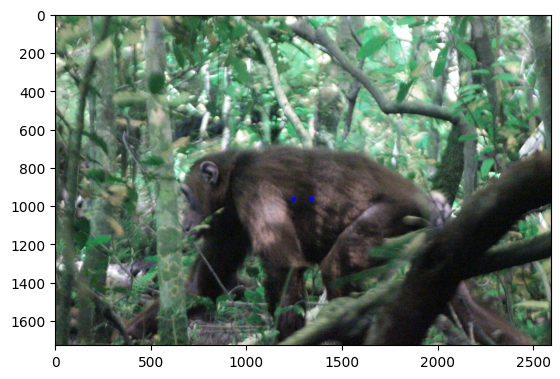

In [ ]:
import cv2
import numpy as np
from skimage.feature import blob_log
import matplotlib.pyplot as plt

# Load the image
img = cv2.imread('281.JPG')  # Update with the path to your image

# Convert from BGR to HSV
hsv_frame = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Define two ranges for red
low_red1 = np.array([0, 120, 70])
high_red1 = np.array([10, 255, 255])
low_red2 = np.array([170, 120, 70])
high_red2 = np.array([180, 255, 255])

# Create masks for red ranges
red_mask1 = cv2.inRange(hsv_frame, low_red1, high_red1)
red_mask2 = cv2.inRange(hsv_frame, low_red2, high_red2)
red_mask = cv2.bitwise_or(red_mask1, red_mask2)

# Apply mask to the image
red = cv2.bitwise_and(img, img, mask=red_mask)

# Extract red channel for processing
r = red[:,:,2]

# Apply Gaussian blur for smoothing
blur = cv2.GaussianBlur(r, (25, 25), 0)

# Apply thresholding
ret3, thresh = cv2.threshold(blur, 210, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Dilation to enlarge dots (tune parameters as needed)
kernel = np.ones((5,5),np.uint8)
thresh = cv2.dilate(thresh, kernel, iterations=3)

# Blob detection using skimage
blobs = blob_log(thresh, max_sigma=50, threshold=0.15)
count = 0
if blobs.size != 0:  # Checks if a blob was found
    for blob in blobs:
        y, x, area = blob
        if area > 1:   # Checks for the area of blob
            count += 1
            result1 = cv2.circle(img, (int(x), int(y)), 12, (0, 0, 255), -1) # Draws circles on detected blobs

# Show the result
plt.imshow(result1)
plt.show()

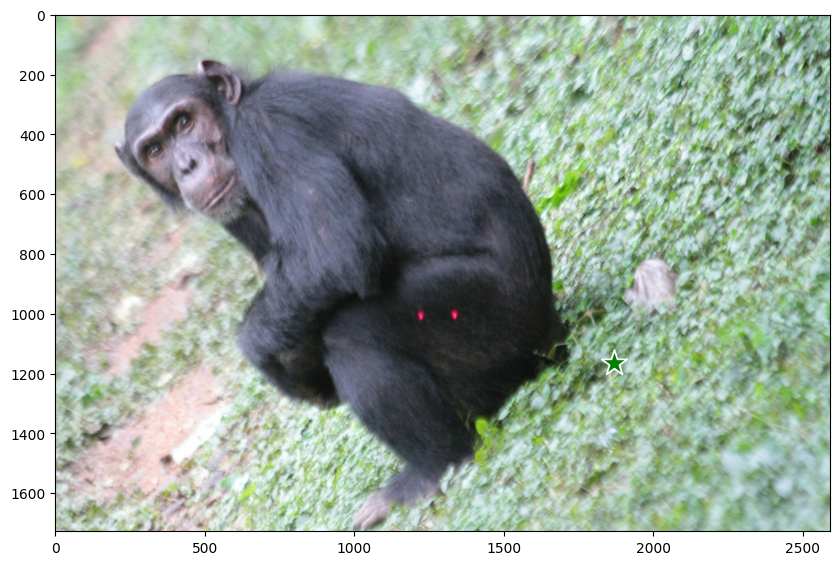

In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

im = cv2.imread('561.JPG')
segment_im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

input_point = np.array([[1870, 1165]]) # SET THIS POINT

input_label = np.array([1])
plt.figure(figsize=(10,10))
plt.imshow(segment_im)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()